Semangat capstonenya ges

Import Package

In [15]:
import tensorflow as tf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Embedding, Flatten, Dense, Concatenate

In [16]:
import tensorflow as tf
print(tf.__version__)

2.15.0


Load Dataset

In [17]:
file_path = 'fake_job_postings.csv'
data = pd.read_csv(file_path)

features = data.iloc[:, :-1]
labels = data.iloc[:, -1]

print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17880 entries, 0 to 17879
Data columns (total 18 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   job_id               17880 non-null  int64 
 1   title                17880 non-null  object
 2   location             17534 non-null  object
 3   department           6333 non-null   object
 4   salary_range         2868 non-null   object
 5   company_profile      14572 non-null  object
 6   description          17879 non-null  object
 7   requirements         15184 non-null  object
 8   benefits             10668 non-null  object
 9   telecommuting        17880 non-null  int64 
 10  has_company_logo     17880 non-null  int64 
 11  has_questions        17880 non-null  int64 
 12  employment_type      14409 non-null  object
 13  required_experience  10830 non-null  object
 14  required_education   9775 non-null   object
 15  industry             12977 non-null  object
 16  func

cek kolom kecurangan dari dataset

fraudulent
0    17014
1      866
Name: count, dtype: int64


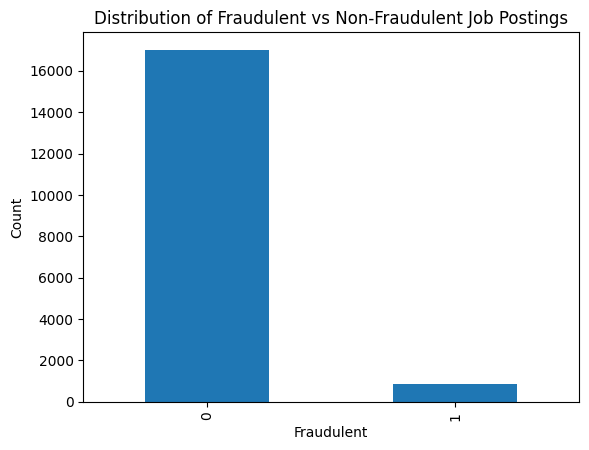

In [18]:
label_counts = data['fraudulent'].value_counts()
print(label_counts)

label_counts.plot(kind='bar')
plt.xlabel('Fraudulent')
plt.ylabel('Count')
plt.title('Distribution of Fraudulent vs Non-Fraudulent Job Postings')
plt.show()

 Cek semua kolom data untuk "balancing" ?

In [19]:
for column in data.columns:
    print(f"Balance check for column '{column}':")
    print(data[column].value_counts())
    print("=" * 30)

Balance check for column 'job_id':
job_id
1        1
11919    1
11925    1
11924    1
11923    1
        ..
5966     1
5967     1
5968     1
5969     1
17880    1
Name: count, Length: 17880, dtype: int64
Balance check for column 'title':
title
English Teacher Abroad                                         311
Customer Service Associate                                     146
Graduates: English Teacher Abroad (Conversational)             144
English Teacher Abroad                                          95
Software Engineer                                               86
                                                              ... 
West Coast Regional Channel Manager (RCM)                        1
BI Practice Manager                                              1
Community Coordinator- Ambassador Programme                      1
Senior Traffic Engineer                                          1
Project Cost Control Staff Engineer - Cost Control Exp - TX      1
Name: count, Length

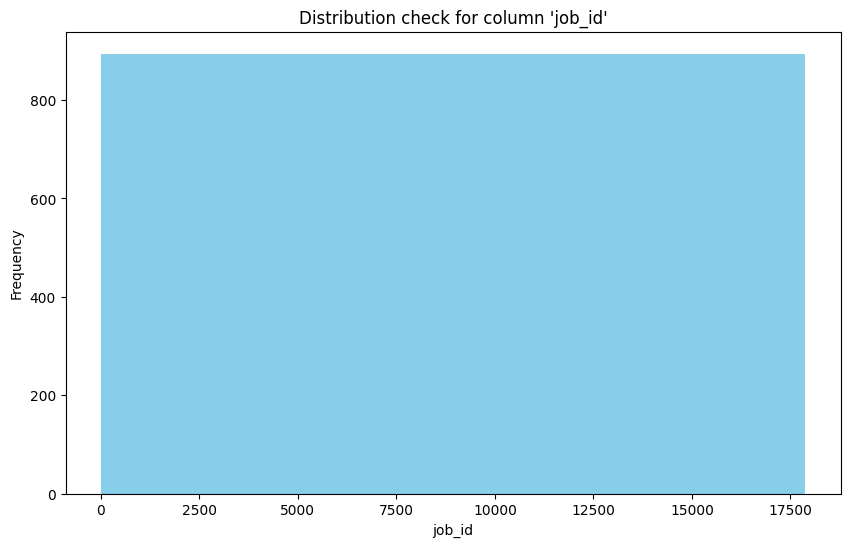

C:\Users\Ramadhan Djibran\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 9 (	) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


ValueError: 
Various GP locums make some $$ while you holiday !
                            ^
ParseException: Expected end of text, found '$'  (at char 28), (line:1, col:29)

<Figure size 1000x600 with 1 Axes>

C:\Users\Ramadhan Djibran\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 9 (	) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Ramadhan Djibran\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 47560 (\N{HANGUL SYLLABLE MA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Ramadhan Djibran\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 54252 (\N{HANGUL SYLLABLE PO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Ramadhan Djibran\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 44396 (\N{HANGUL SYLLABLE GU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Ramadhan Djibran\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 46041

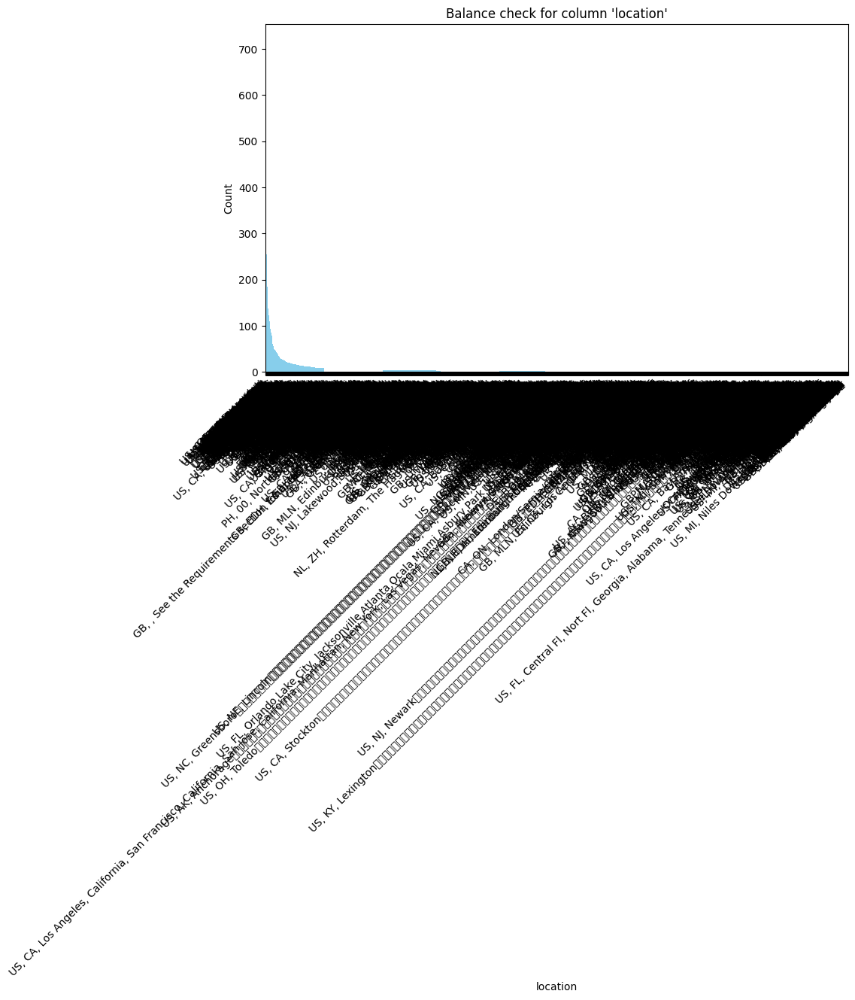

C:\Users\Ramadhan Djibran\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 9 (	) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


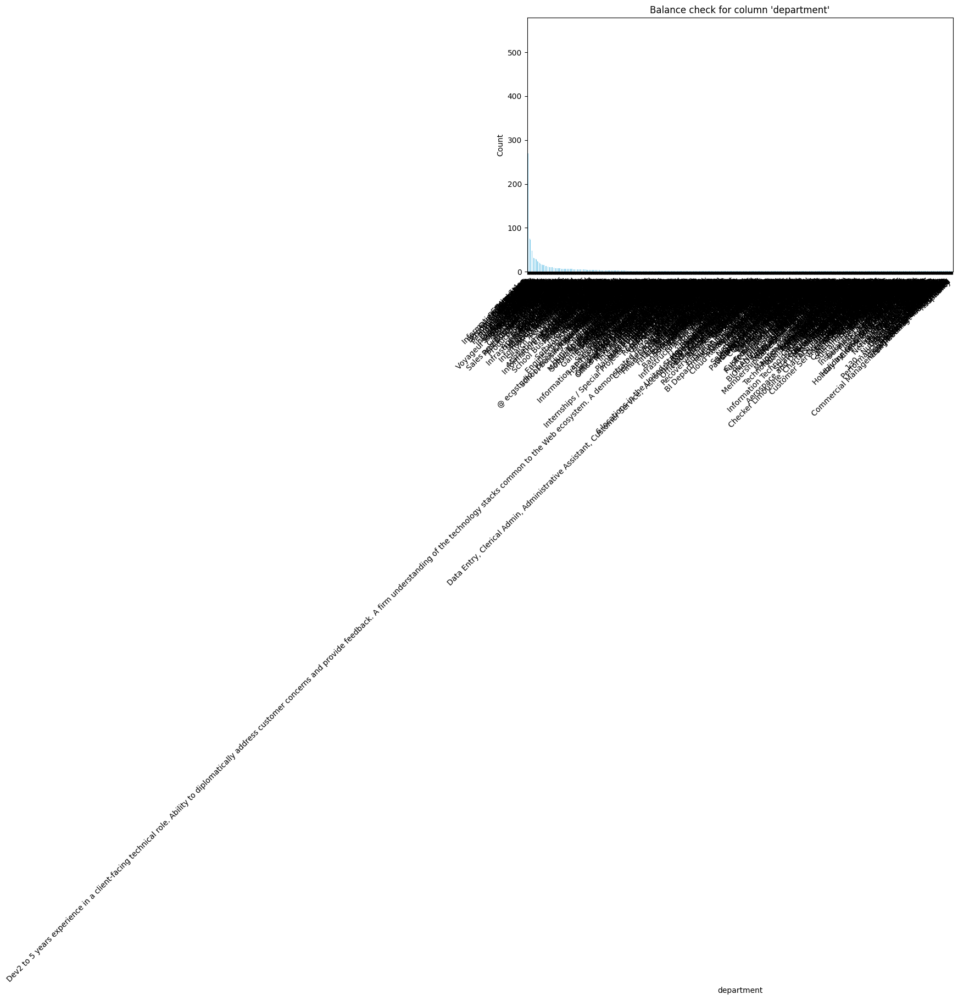

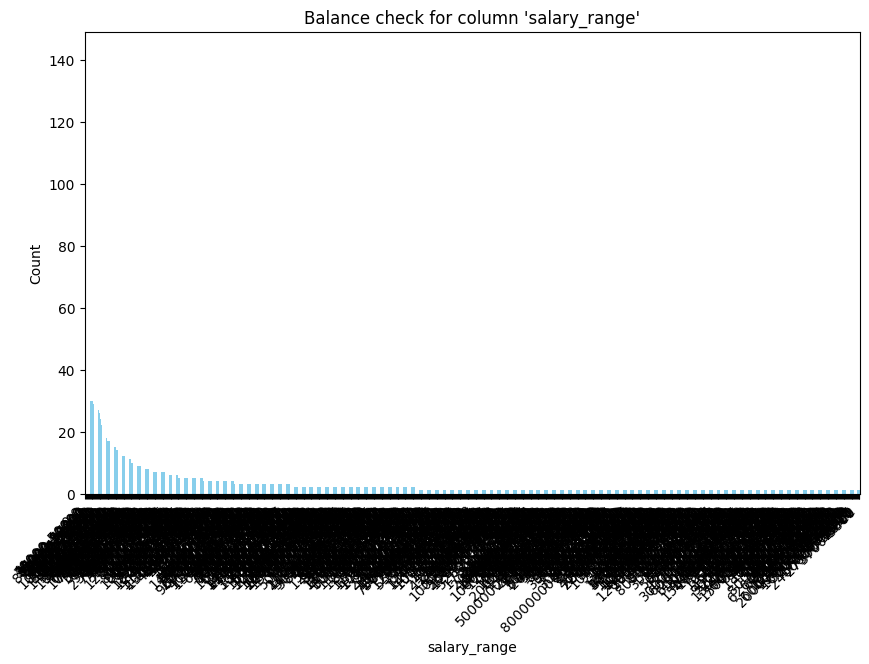

C:\Users\Ramadhan Djibran\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 20320 (\N{CJK UNIFIED IDEOGRAPH-4F60}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Ramadhan Djibran\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 20540 (\N{CJK UNIFIED IDEOGRAPH-503C}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Ramadhan Djibran\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 24471 (\N{CJK UNIFIED IDEOGRAPH-5F97}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Ramadhan Djibran\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 25793 (\N{CJK UNIFIED IDEOGRAPH-64C1}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Ramadhan Djibran\AppData\Roaming\Python\Python311\site-packages

ValueError: 
ONLY ONE MANAGER POSITION PER CITY/REGION IS OPEN RIGHT NOW! WORKED FROM HOME BY PHONE OR IN PERSON LOCALLY – YOUR CHOICE! OVER 40 MAJOR CITIES STILL AVAILABLE! YOU WILL EARN 40% OF THE GROSS PROFIT ON YOUR TEAMS FUNDED DEALS! YOU WILL EARN 40% OF THE GROSS PROFITS FROM YOUR TEAMS RENEWALS AND STACKS! YOU WILL EARN 10% OF THE CLIENT EQUITY IN YOUR TEAMS CLIENT BASE! PLUS: YOU WILL EARN 60% OF FUNDED AMOUNT COMMISSIONS ON YOUR OWN DEALS YOU WILL EARN 50% OF ALL EXTRA FEES CHARGED ON YOUR OWN DEALS YOU WILL EARN 50% OF THE CLIENT EQUITY IN YOUR OWN CLIENT BASE! If you are working in the merchant cash advance/small business funding industry and want to create your own team of reps who can also have the ability to recruit their own reps in to your team, and you want to get paid from all of their efforts, then read this ad carefully. Our company has preferred relationships with over 30 different private funding sources and we have a great reputation. Our name is not in this ad to prevent us from showing up in Google indexing under our company name, which would then let our existing and potential clients know how much commission we all make. What a disaster that would be. Wouldn't you agree? But once we give you our name and you check us out you will see that we are the real deal. We have management positions available to a limited number of individuals that are hungry to build a six figure income and client base in the small business funding industry. We will only take on one manager to cover one geographic area (city or state or region; depending upon population density), and that manager will have the right to recruit within your assigned territory and can have their team get deals funded from all over the country. The best part is that this can all be done over the phone, if you qualify. Your manager's agreement allows you to build your own sales team of reps for our company, and to get paid 40% of the gross profit on each of their funded deals. Gross profit for our Agreement is the amount left over after the contracted reps on your team are paid their commissions. Your recruited reps earn either 3%, 5% or 6% on the funded amount of their deals (depending upon the repayment term), plus they earn 50% of any extra fees charged by our company. An Example would be, if the deal is a good $50,000 first position with a restaurant or trucking company or some industry that is inside the box for our type of business, then we can now get up to 12% of the funded amount (or more in some cases), as a top sell rate commission from our funders. Plus we can charge fees on most first position deals of another 2% to 4% (first positions being deals where no other funding is in place). If we pay your rep 5% to 6% on a deal like that, plus 50% of the fees, then there is a lot of room left over for profit. On 50K at 12% plus 3% in fees if the rep got 5% commission on the funded amount and 1 and 1/2% in fee commissions ($3250 commission), there would be 7% + 1 and 1/2% left in gross profit for our company and the manager to split 60/40. So $4250 gross profit on that deal = a $1700 override commission for you the manager. Imagine 20 or more of those overrides per month. Even on the subprime deals (2nd, 3rd positions, gas stations, sub 500 credit, 6 months in business, etc.) we can now get 6% to 8% of the funded amount, plus charge 3% to 12% in fees depending upon the deal. So on a real bad deal, worst case scenario, the reps gets 3%, Our company gets 3% on the funded as commission and our company and the rep split another 5% in fees. On a 50K subprime deal, that would equal $2750 in gross profit for our company which is an $1100 override commission for you as the manager. Your manager’s agreement also prevents you from be circumvented by your reps. Once they sign up through you they are locked in to you as long as you remain with our company, and you even get paid residuals up to 2 years after your last active date with us, if you ever left. This opportunity is for a limited time, and even though there is no set quota, if some decent level of performance is not met then the opportunity would be revoked after 30 to 60 days. We also would provide you with an ad to run in your designated city and would re-reimburse you with override commissions paid,  We would also provide you and your recruited reps with a company e-mail and all of your recruiting must be done through that e-mail. We have a very unique way of selling these business funding products and it is working for our reps in a big way. We will provide you with scripts and materials that you can give your reps, but ultimately it will be up to you to: A. Recruit Them (using our ad or your own, and by using your contacts locally) B. Train Them (using our scripts combined with your experience and industry knowledge) C. Manage Them (keep them motivated, answer questions and act as their liaison with our company) If you do these 3 things, and keep doing it, then you will build a six figure income from this business. If you do these things well you can build a huge income and a book of business that you can cash out on in the future should we sell or go public; which is why we are in this business, besides the great profit margins. This is a very lucrative opportunity for the right person. If you are not experienced in this business then do not reply to this ad. If you are a rep sitting in someone else's business making 3% or 4% of the funded amount of your deals (or less), with little or no residuals and no client equity, and want a chance to build your own team and get paid leveraged income and residual income from the efforts of others, then we welcome you to apply. We will only give this position to one person to cover any one city, even though you and your team can get deals from all over the country, you can only recruit reps on CL in your designated area. But you may recruit offline wherever you want. So when you apply be convincing enough for us to call you back. Again, "NO EXPERIENCE IN THE MCA INDUSTRY", "NO POSITION". . .  
                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                  ^
ParseException: Expected end of text, found '$'  (at char 2322), (line:1, col:2323)

<Figure size 1000x600 with 1 Axes>

C:\Users\Ramadhan Djibran\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 61623 (\uf0b7) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Ramadhan Djibran\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 12288 (\N{IDEOGRAPHIC SPACE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Ramadhan Djibran\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 61607 (\uf0a7) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Ramadhan Djibran\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 24037 (\N{CJK UNIFIED IDEOGRAPH-5DE5}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Ramadhan Djibran\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 20316

In [ ]:
# Assuming 'data' is your DataFrame
for column in data.columns:
    plt.figure(figsize=(10, 6))

    if data[column].dtype == 'object':
        # Categorical data - Bar plot
        data[column].value_counts().plot(kind='bar', color='skyblue')
        plt.title(f"Balance check for column '{column}'")
        plt.xlabel(column)
        plt.ylabel("Count")
        plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility
    else:
        # Numerical data - Histogram
        plt.hist(data[column], bins=20, color='skyblue')  # Adjust the number of bins as needed
        plt.title(f"Distribution check for column '{column}'")
        plt.xlabel(column)
        plt.ylabel("Frequency")

    plt.show()

In [ ]:
categorical_cols = ['title', 'location', 'department', 'employment_type', 'required_experience', 'required_education', 'industry', 'function']
numerical_cols = ['telecommuting', 'has_company_logo', 'has_questions']

label_encoders = {}
for col in categorical_cols:
    le = LabelEncoder()
    data[col] = le.fit_transform(data[col])
    label_encoders[col] = le

X_categorical = data[categorical_cols].values
X_numerical = data[numerical_cols].values
X = [X_categorical[:, i] for i in range(X_categorical.shape[1])] + [X_numerical]

y = data['fraudulent'].values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

def create_model():
    input_layers = []
    embedding_layers = []

    for i in range(len(categorical_cols)):
        input_layer = Input(shape=(1,))
        embedding_layer = Embedding(input_dim=np.max(X_categorical[:, i]) + 1, output_dim=10)(input_layer)
        input_layers.append(input_layer)
        embedding_layers.append(embedding_layer)

    flattened_layers = [Flatten()(layer) for layer in embedding_layers]

    input_layers += [Input(shape=(1,)) for _ in numerical_cols]
    all_layers = flattened_layers + input_layers
    concatenated = Concatenate()(all_layers)

    dense1 = Dense(128, activation='relu')(concatenated)
    dense2 = Dense(64, activation='relu')(dense1)

    output_layer = Dense(1, activation='sigmoid')(dense2)

    model = Model(inputs=all_layers, outputs=output_layer)
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

    return model

model = create_model()
model.fit(X_train, y_train, epochs=10, batch_size=64, validation_split=0.2)

loss, accuracy = model.evaluate(X_test, y_test)
print(f'Test Accuracy: {accuracy * 100:.2f}%')

In [ ]:
# Convert y to binary labels (if not already)
y = np.array(y)
y_binary = np.where(y == 1, 1, 0)

In [ ]:
def create_binary_model():
    input_layers = []
    embedding_layers = []

    for i in range(len(categorical_cols)):
        input_layer = Input(shape=(1,))
        embedding_layer = Embedding(input_dim=np.max(X_categorical[:, i]) + 1, output_dim=10)(input_layer)
        input_layers.append(input_layer)
        embedding_layers.append(embedding_layer)

    flattened_layers = [Flatten()(layer) for layer in embedding_layers]

    input_layers += [Input(shape=(1,)) for _ in numerical_cols]
    all_layers = flattened_layers + input_layers
    concatenated = Concatenate()(all_layers)

    dense1 = Dense(128, activation='relu')(concatenated)
    dense2 = Dense(64, activation='relu')(dense1)

    output_layer = Dense(1, activation='sigmoid')(dense2)

    model = Model(inputs=all_layers, outputs=output_layer)
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

    return model

binary_model = create_binary_model()
binary_model.fit(X_train, y_train, epochs=10, batch_size=64, validation_split=0.2)

loss, accuracy = binary_model.evaluate(X_test, y_test)
print(f'Test Accuracy: {accuracy * 100:.2f}%')